# Customer analysis in marketing campaigns

In this exercise, you work for a consulting firm as data scientist. In this scenario, your client is the marketing team of a grocery store. They would like to find which are the ideal customers according to the results of the last marketing campaigns. Your analysis will be helpful to adapt and modify products according to the different needs and behavior of their customers.

You dispose of a dataset from the mall dataset with several features:


People

- ID: Customer's unique identifier
- Year_Birth: Customer's birth year
- Education: Customer's education level
- Marital_Status: Customer's marital status
- Income: Customer's yearly household income
- Kidhome: Number of children in customer's household
- Teenhome: Number of teenagers in customer's household
- Dt_Customer: Date of customer's enrollment with the company
- Recency: Number of days since customer's last purchase
- Complain: 1 if customer complained in the last 2 years, 0 otherwise

Products

- MntWines: Amount spent on wine in last 2 years
- MntFruits: Amount spent on fruits in last 2 years
- MntMeatProducts: Amount spent on meat in last 2 years
- MntFishProducts: Amount spent on fish in last 2 years
- MntSweetProducts: Amount spent on sweets in last 2 years
- MntGoldProds: Amount spent on gold in last 2 years

Promotion

- NumDealsPurchases: Number of purchases made with a discount
- AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
- AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
- AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
- AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
- AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
- Response: 1 if customer accepted the offer in the last campaign, 0 otherwise

Place

- NumWebPurchases: Number of purchases made through the company’s web site
- NumCatalogPurchases: Number of purchases made using a catalogue
- NumStorePurchases: Number of purchases made directly in stores
- NumWebVisitsMonth: Number of visits to company’s web site in the last month

'Z_CostContact' and 'Z_Revenue' contains constant value across all the observations and therefore they will not contribute anything in the analysis.

You have two days to do this study

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from datetime import datetime

from sklearn.preprocessing import OneHotEncoder

from sklearn.preprocessing import MinMaxScaler

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [2]:
campaign_df = pd.read_csv('../data/marketing_campaign.csv', sep="\t")
campaign_df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,...,3,0,0,0,0,0,0,3,11,0


In [3]:
campaign_df.shape

(2240, 29)

In [4]:
campaign_df=campaign_df.drop(columns=['Z_CostContact','Z_Revenue'], axis=1)

In [5]:
people = campaign_df[['ID','Year_Birth','Education','Marital_Status','Income','Kidhome','Teenhome','Dt_Customer','Recency','Complain']]
products = campaign_df[['ID', 'MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds']]
promotion = campaign_df[['ID','NumDealsPurchases','AcceptedCmp1','AcceptedCmp2','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response']]
place = campaign_df[['ID','NumWebPurchases','NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth']]

# EDA

In [6]:
people.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ID              2240 non-null   int64  
 1   Year_Birth      2240 non-null   int64  
 2   Education       2240 non-null   object 
 3   Marital_Status  2240 non-null   object 
 4   Income          2216 non-null   float64
 5   Kidhome         2240 non-null   int64  
 6   Teenhome        2240 non-null   int64  
 7   Dt_Customer     2240 non-null   object 
 8   Recency         2240 non-null   int64  
 9   Complain        2240 non-null   int64  
dtypes: float64(1), int64(6), object(3)
memory usage: 175.1+ KB


In [7]:
people['Dt_Customer'] = people['Dt_Customer'].apply(pd.to_datetime)
campaign_df['Dt_Customer'] = campaign_df['Dt_Customer'].apply(pd.to_datetime)

<ipython-input-7-b6f8f3c4d001>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  people['Dt_Customer'] = people['Dt_Customer'].apply(pd.to_datetime)


In [8]:
people.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,Complain
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,0.009375
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,0.096391
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1.000000


In [9]:
people['Dt_Customer'].min()

Timestamp('2012-01-08 00:00:00')

In [10]:
people['Dt_Customer'].max()

Timestamp('2014-12-06 00:00:00')

In [11]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   ID                2240 non-null   int64
 1   MntWines          2240 non-null   int64
 2   MntFruits         2240 non-null   int64
 3   MntMeatProducts   2240 non-null   int64
 4   MntFishProducts   2240 non-null   int64
 5   MntSweetProducts  2240 non-null   int64
 6   MntGoldProds      2240 non-null   int64
dtypes: int64(7)
memory usage: 122.6 KB


In [12]:
products.describe()

,ID,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875
std,3246.662198,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000
50%,5458.500000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000
75%,8427.750000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000
max,11191.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000


In [13]:
promotion.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype
---  ------             --------------  -----
 0   ID                 2240 non-null   int64
 1   NumDealsPurchases  2240 non-null   int64
 2   AcceptedCmp1       2240 non-null   int64
 3   AcceptedCmp2       2240 non-null   int64
 4   AcceptedCmp3       2240 non-null   int64
 5   AcceptedCmp4       2240 non-null   int64
 6   AcceptedCmp5       2240 non-null   int64
 7   Response           2240 non-null   int64
dtypes: int64(8)
memory usage: 140.1 KB


In [14]:
promotion.describe()

,ID,NumDealsPurchases,AcceptedCmp1,AcceptedCmp2,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,Response
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,2.325000,0.064286,0.013393,0.072768,0.074554,0.072768,0.149107
std,3246.662198,1.932238,0.245316,0.114976,0.259813,0.262728,0.259813,0.356274
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5458.500000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8427.750000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,11191.000000,15.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [15]:
place.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype
---  ------               --------------  -----
 0   ID                   2240 non-null   int64
 1   NumWebPurchases      2240 non-null   int64
 2   NumCatalogPurchases  2240 non-null   int64
 3   NumStorePurchases    2240 non-null   int64
 4   NumWebVisitsMonth    2240 non-null   int64
dtypes: int64(5)
memory usage: 87.6 KB


In [16]:
place.describe()

,ID,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,4.084821,2.662054,5.790179,5.316518
std,3246.662198,2.778714,2.923101,3.250958,2.426645
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,2.000000,0.000000,3.000000,3.000000
50%,5458.500000,4.000000,2.000000,5.000000,6.000000
75%,8427.750000,6.000000,4.000000,8.000000,7.000000
max,11191.000000,27.000000,28.000000,13.000000,20.000000


In [17]:
campaign_df = campaign_df.drop([239,339,192,2233],axis=0)

In [18]:
people[people['Income']==people['Income'].max()]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,Complain
2233,9432,1977,Graduation,Together,666666.0,1,0,2013-02-06,23,0


In [19]:
campaign_df[campaign_df['Income'].isnull() == True]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
10,1994,1983,Graduation,Married,NaN,1,0,2013-11-15,11,5,...,0,2,7,0,0,0,0,0,0,0
27,5255,1986,Graduation,Single,NaN,1,0,2013-02-20,19,5,...,0,0,1,0,0,0,0,0,0,0
43,7281,1959,PhD,Single,NaN,0,0,2013-05-11,80,81,...,3,4,2,0,0,0,0,0,0,0
48,7244,1951,Graduation,Single,NaN,2,1,2014-01-01,96,48,...,1,4,6,0,0,0,0,0,0,0
58,8557,1982,Graduation,Single,NaN,1,0,2013-06-17,57,11,...,0,3,6,0,0,0,0,0,0,0
71,10629,1973,2n Cycle,Married,NaN,1,0,2012-09-14,25,25,...,0,3,8,0,0,0,0,0,0,0
90,8996,1957,PhD,Married,NaN,2,1,2012-11-19,4,230,...,2,8,9,0,0,0,0,0,0,0
91,9235,1957,Graduation,Single,NaN,1,1,2014-05-27,45,7,...,0,2,7,0,0,0,0,0,0,0
92,5798,1973,Master,Together,NaN,0,0,2013-11-23,87,445,...,4,8,1,0,0,0,0,0,0,0
128,8268,1961,PhD,Married,NaN,0,1,2013-11-07,23,352,...,1,7,6,0,0,0,0,0,0,0


In [20]:
campaign_df.dropna(axis=0,inplace=True)

##### Duplicats

In [21]:
duplicats=campaign_df.drop('ID',axis=1)[campaign_df.drop('ID',axis=1).duplicated()==True].index

In [22]:
campaign_df = campaign_df.drop(duplicats,axis=0)

In [23]:
campaign_df[campaign_df.drop(["Response","ID"], axis=1).duplicated()==True]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
408,5049,1974,PhD,Together,30351.0,1,0,2013-06-06,19,14,...,0,2,9,0,0,0,0,0,0,0
486,5172,1976,Master,Together,65104.0,0,1,2013-11-14,4,738,...,5,7,7,0,0,0,0,0,0,0
1008,8975,1968,Graduation,Married,19514.0,1,1,2014-01-26,47,14,...,1,2,8,1,0,0,0,0,0,0
1093,9080,1972,PhD,Single,38578.0,1,1,2013-06-22,2,38,...,0,3,8,0,0,0,0,0,0,0
1342,873,1949,Master,Married,62845.0,1,1,2012-01-10,3,1099,...,4,10,8,0,1,0,0,0,0,1
1373,5675,1960,PhD,Divorced,50611.0,0,1,2012-04-10,98,459,...,5,7,6,0,1,0,0,0,0,0
1426,8254,1974,PhD,Married,34596.0,1,0,2013-04-13,48,14,...,0,2,8,0,0,0,0,0,0,0
1533,2804,1975,Master,Single,46098.0,1,1,2012-08-18,86,57,...,2,2,8,0,0,0,0,0,0,1
1572,5350,1991,Master,Single,90638.0,0,0,2014-02-13,29,1156,...,4,10,1,0,0,1,0,0,0,1
1584,4608,1987,Graduation,Divorced,81361.0,0,0,2014-02-25,18,163,...,10,13,1,0,0,0,0,0,0,1


In [24]:
duplicats2=campaign_df.drop(["Response","ID"],axis=1)[campaign_df.drop(["Response","ID"],axis=1).duplicated()==True].index

In [25]:
campaign_df = campaign_df.drop(duplicats2,axis=0)

In [26]:
campaign_df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-04-09,58,635,...,10,4,7,0,0,0,0,0,0,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-08-03,38,11,...,1,2,5,0,0,0,0,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,2,10,4,0,0,0,0,0,0,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-10-02,26,11,...,0,4,6,0,0,0,0,0,0,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,3,6,5,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2232,8080,1986,Graduation,Single,26816.0,0,0,2012-08-17,50,5,...,0,3,4,0,0,0,0,0,0,0
2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,709,...,3,4,5,0,0,0,0,0,0,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,908,...,3,13,6,0,1,0,0,0,0,0
2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,428,...,5,10,3,0,0,0,0,0,0,0


##### Pairplots

In [27]:
people = campaign_df[['ID','Year_Birth','Education','Marital_Status','Income','Kidhome','Teenhome','Dt_Customer','Recency','Complain']]
products = campaign_df[['ID', 'MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds']]
promotion = campaign_df[['ID','NumDealsPurchases','AcceptedCmp1','AcceptedCmp2','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response']]
place = campaign_df[['ID','NumWebPurchases','NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth']]

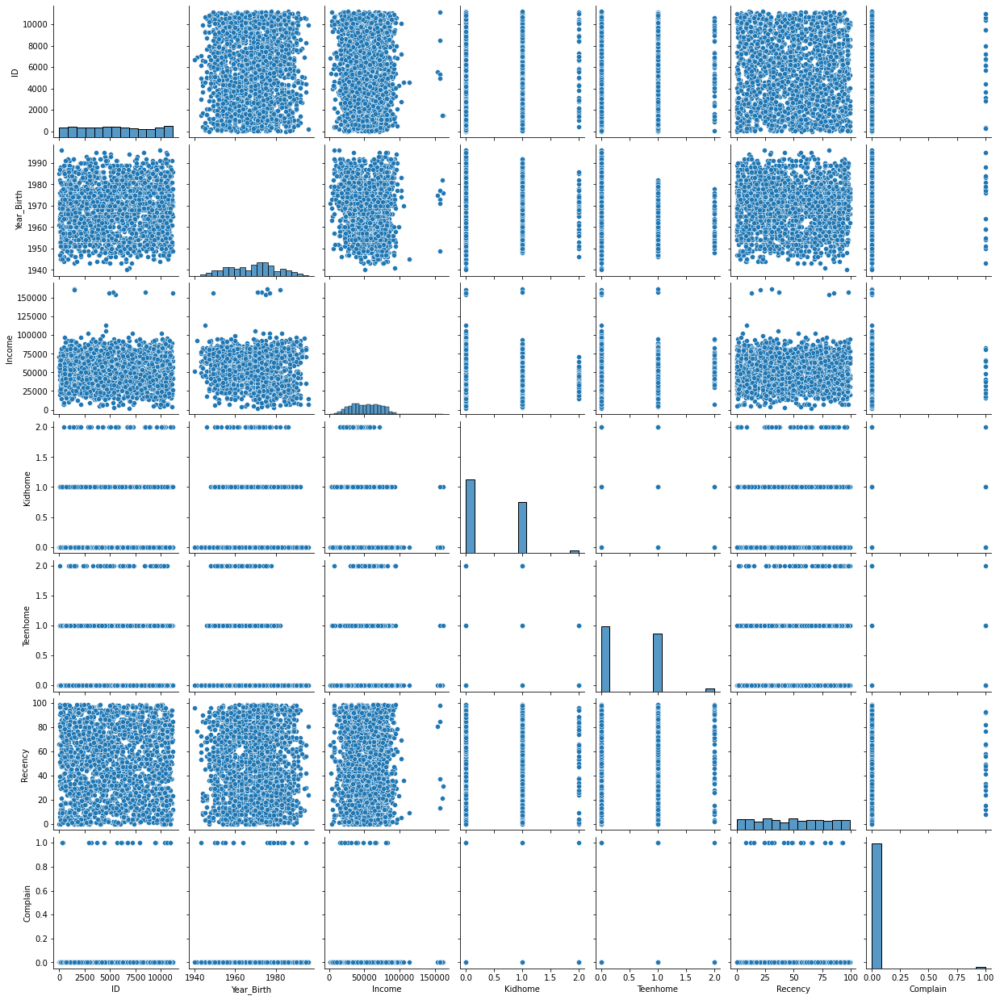

In [28]:
sns.pairplot(people)

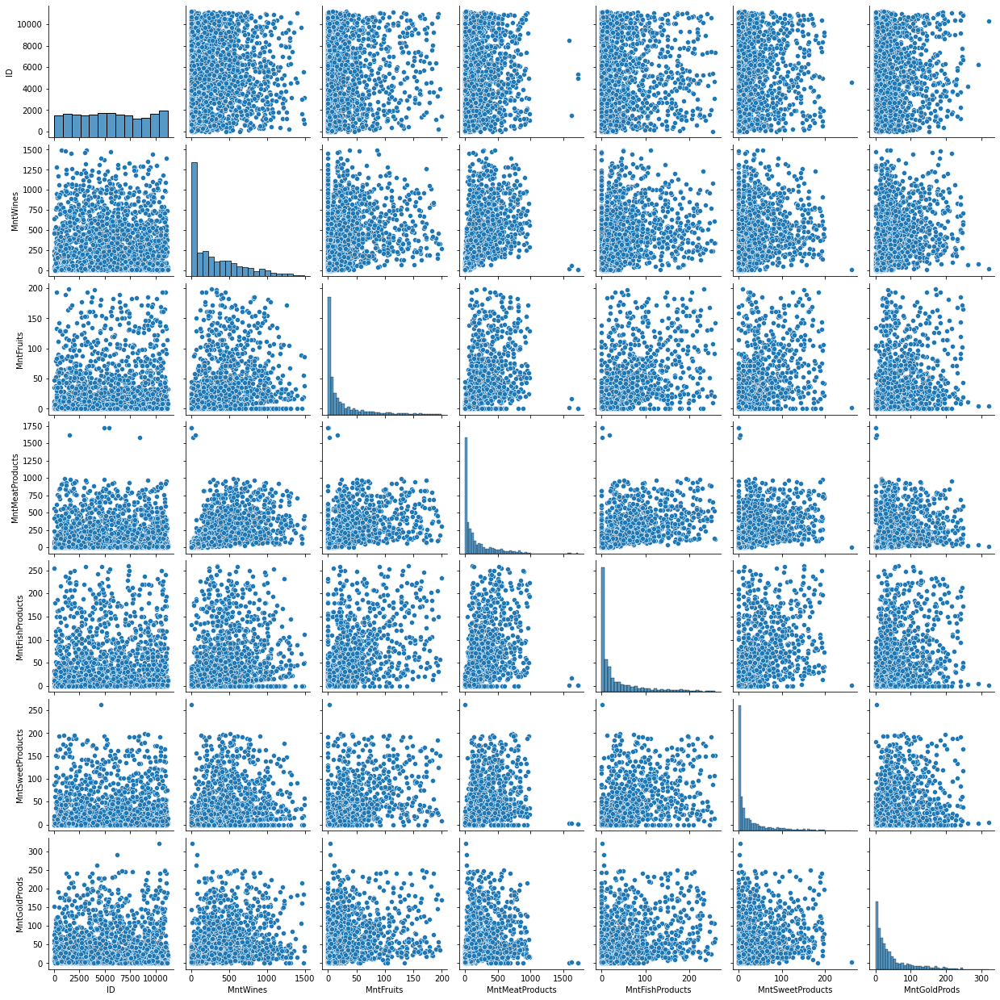

In [33]:
sns.pairplot(products)

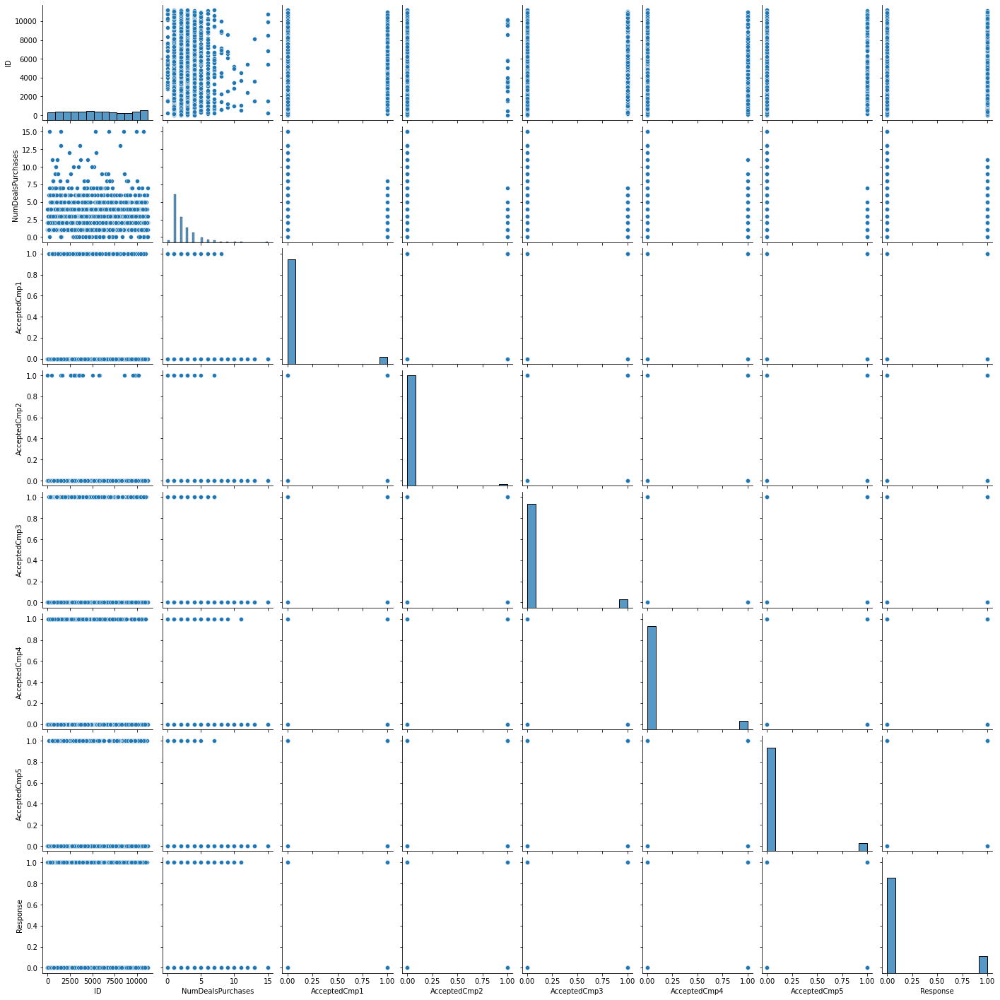

In [30]:
sns.pairplot(promotion)

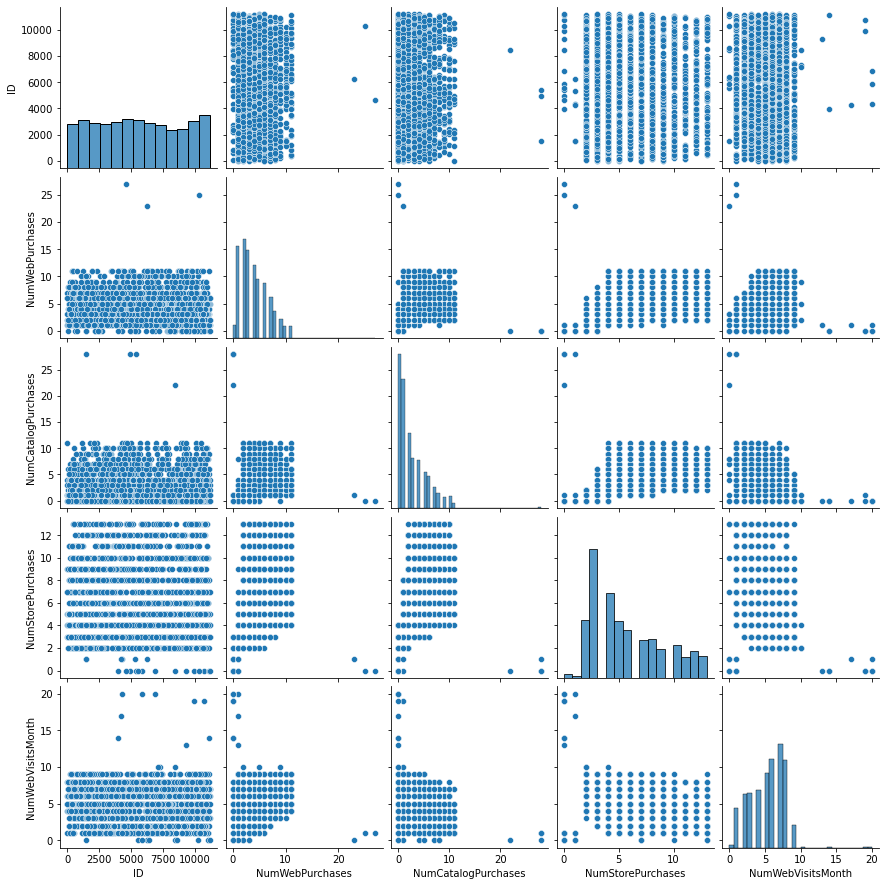

In [31]:
sns.pairplot(place)

### Encoding

In [34]:
campaign_df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-04-09,58,635,...,10,4,7,0,0,0,0,0,0,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-08-03,38,11,...,1,2,5,0,0,0,0,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,2,10,4,0,0,0,0,0,0,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-10-02,26,11,...,0,4,6,0,0,0,0,0,0,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,3,6,5,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2232,8080,1986,Graduation,Single,26816.0,0,0,2012-08-17,50,5,...,0,3,4,0,0,0,0,0,0,0
2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,709,...,3,4,5,0,0,0,0,0,0,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,908,...,3,13,6,0,1,0,0,0,0,0
2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,428,...,5,10,3,0,0,0,0,0,0,0


In [35]:
print(f"Education : {campaign_df['Education'].unique()}")
print(f"Marital_Status : {campaign_df['Marital_Status'].unique()}")

Education : ['Graduation' 'PhD' 'Master' 'Basic' '2n Cycle']
Marital_Status : ['Single' 'Together' 'Married' 'Divorced' 'Widow' 'Alone' 'Absurd' 'YOLO']


In [36]:
campaign_df['Marital_Status'].value_counts()

Married     781
Together    508
Single      435
Divorced    212
Widow        69
Alone         3
Absurd        2
YOLO          1
Name: Marital_Status, dtype: int64

In [37]:
campaign_df = campaign_df.drop(campaign_df[campaign_df['Marital_Status']=='Absurd'].index,axis=0)
campaign_df = campaign_df.drop(campaign_df[campaign_df['Marital_Status']=='YOLO'].index,axis=0)

In [38]:
campaign_df = campaign_df.replace('Alone','Single')

In [39]:
campaign_df.reset_index(inplace=True)

In [40]:
campaign_df

,index,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,0,5524,1957,Graduation,Single,58138.0,0,0,2012-04-09,58,...,10,4,7,0,0,0,0,0,0,1
1,1,2174,1954,Graduation,Single,46344.0,1,1,2014-08-03,38,...,1,2,5,0,0,0,0,0,0,0
2,2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,...,2,10,4,0,0,0,0,0,0,0
3,3,6182,1984,Graduation,Together,26646.0,1,0,2014-10-02,26,...,0,4,6,0,0,0,0,0,0,0
4,4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,...,3,6,5,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2003,2232,8080,1986,Graduation,Single,26816.0,0,0,2012-08-17,50,...,0,3,4,0,0,0,0,0,0,0
2004,2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,...,3,4,5,0,0,0,0,0,0,0
2005,2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,...,3,13,6,0,1,0,0,0,0,0
2006,2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,...,5,10,3,0,0,0,0,0,0,0


In [41]:
enc = OneHotEncoder(handle_unknown='ignore')
enc_df = enc.fit(campaign_df[['Education']])
enc_df = pd.DataFrame(enc.transform(campaign_df[['Education']]).toarray())
enc_df.columns = ['2n Cycle', 'Basic','Graduation', 'Master','PhD']

In [42]:
campaign_df = campaign_df.merge(enc_df, on=campaign_df.index)
campaign_df = campaign_df.drop(['Education', 'key_0'], axis=1)

In [43]:
campaign_df

,index,ID,Year_Birth,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,2n Cycle,Basic,Graduation,Master,PhD
0,0,5524,1957,Single,58138.0,0,0,2012-04-09,58,635,...,0,0,0,0,1,0.0,0.0,1.0,0.0,0.0
1,1,2174,1954,Single,46344.0,1,1,2014-08-03,38,11,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
2,2,4141,1965,Together,71613.0,0,0,2013-08-21,26,426,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
3,3,6182,1984,Together,26646.0,1,0,2014-10-02,26,11,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
4,4,5324,1981,Married,58293.0,1,0,2014-01-19,94,173,...,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2003,2232,8080,1986,Single,26816.0,0,0,2012-08-17,50,5,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
2004,2235,10870,1967,Married,61223.0,0,1,2013-06-13,46,709,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
2005,2237,7270,1981,Divorced,56981.0,0,0,2014-01-25,91,908,...,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0
2006,2238,8235,1956,Together,69245.0,0,1,2014-01-24,8,428,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0


In [45]:
enc2 = OneHotEncoder(handle_unknown='ignore')
enc_df2 = enc2.fit(campaign_df[['Marital_Status']])
enc_df2 = pd.DataFrame(enc2.transform(campaign_df[['Marital_Status']]).toarray())
enc_df2.columns = ['Divorced','Married','Single', 'Together','Widow']
enc_df2

,Divorced,Married,Single,Together,Widow
0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,1.0,0.0
4,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...
2003,0.0,0.0,1.0,0.0,0.0
2004,0.0,1.0,0.0,0.0,0.0
2005,1.0,0.0,0.0,0.0,0.0
2006,0.0,0.0,0.0,1.0,0.0


In [46]:
campaign_df = campaign_df.merge(enc_df2, on=campaign_df.index)
campaign_df = campaign_df.drop(['Marital_Status', 'key_0'], axis=1)

In [47]:
campaign_df = campaign_df.drop('index', axis=1)

### Scaling

In [48]:
Xmms = campaign_df.drop(['ID','2n Cycle','Basic','Graduation','Master','PhD','Divorced','Married','Single','Together','Widow','Kidhome','Teenhome','Complain','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','AcceptedCmp1','AcceptedCmp2','Dt_Customer','Response'], axis=1)

In [49]:
mms = MinMaxScaler()
ft_mms = mms.fit(Xmms)
campaign_df_mms = ft_mms.transform(Xmms)
campaign_df_mms = pd.DataFrame(campaign_df_mms, columns=Xmms.columns)

In [51]:
campaign_df = campaign_df.drop(['Year_Birth','Income','Recency','MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds','NumDealsPurchases','NumWebPurchases','NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth'], axis=1)
campaign_df = campaign_df.merge(campaign_df_mms, on=campaign_df.index)
campaign_df = campaign_df.drop('key_0', axis=1)

,ID,Kidhome,Teenhome,Dt_Customer,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,...,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
0,5524,0,0,2012-04-09,0,0,0,0,0,0,...,0.442211,0.316522,0.664093,0.335878,0.274143,0.200000,0.296296,0.357143,0.307692,0.35
1,2174,1,1,2014-08-03,0,0,0,0,0,0,...,0.005025,0.003478,0.007722,0.003817,0.018692,0.133333,0.037037,0.035714,0.153846,0.25
2,4141,0,0,2013-08-21,0,0,0,0,0,0,...,0.246231,0.073623,0.428571,0.080153,0.130841,0.066667,0.296296,0.071429,0.769231,0.20
3,6182,1,0,2014-10-02,0,0,0,0,0,0,...,0.020101,0.011594,0.038610,0.011450,0.015576,0.133333,0.074074,0.000000,0.307692,0.30
4,5324,1,0,2014-01-19,0,0,0,0,0,0,...,0.216080,0.068406,0.177606,0.103053,0.046729,0.333333,0.185185,0.107143,0.461538,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2003,8080,0,0,2012-08-17,0,0,0,0,0,0,...,0.005025,0.003478,0.011583,0.015267,0.009346,0.066667,0.000000,0.000000,0.230769,0.20
2004,10870,0,1,2013-06-13,0,0,0,0,0,0,...,0.216080,0.105507,0.162162,0.450382,0.769470,0.133333,0.333333,0.107143,0.307692,0.25
2005,7270,0,0,2014-01-25,0,1,0,0,0,0,...,0.241206,0.125797,0.123552,0.045802,0.074766,0.066667,0.074074,0.107143,1.000000,0.30
2006,8235,0,1,2014-01-24,0,0,0,0,0,0,...,0.150754,0.124058,0.308880,0.114504,0.190031,0.133333,0.222222,0.178571,0.769231,0.15


### Correlations

In [53]:
X = campaign_df.drop('ID', axis=1)
Xcorr = campaign_df.drop(['ID','Dt_Customer'], axis=1)

In [54]:
campaign_df_corr = Xcorr.corr()
plt.figure(figsize=(18,18))
sns.heatmap(Xcorr, annot=True)
plt.show()

KeyboardInterrupt: 

# Customer Segmentation

In [63]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from yellowbrick.cluster import KElbowVisualizer

In [134]:
pd.set_option('display.max_columns', None)
Xcorr

,Kidhome,Teenhome,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,2n Cycle,Basic,Graduation,Master,PhD,Divorced,Married,Single,Together,Widow,Year_Birth,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
0,0,0,0,0,0,0,0,0,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.303571,0.351086,0.585859,0.425318,0.442211,0.316522,0.664093,0.335878,0.274143,0.200000,0.296296,0.357143,0.307692,0.35
1,1,1,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.250000,0.277680,0.383838,0.007368,0.005025,0.003478,0.007722,0.003817,0.018692,0.133333,0.037037,0.035714,0.153846,0.25
2,0,0,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.446429,0.434956,0.262626,0.285332,0.246231,0.073623,0.428571,0.080153,0.130841,0.066667,0.296296,0.071429,0.769231,0.20
3,1,0,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.785714,0.155079,0.262626,0.007368,0.020101,0.011594,0.038610,0.011450,0.015576,0.133333,0.074074,0.000000,0.307692,0.30
4,1,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.732143,0.352051,0.949495,0.115874,0.216080,0.068406,0.177606,0.103053,0.046729,0.333333,0.185185,0.107143,0.461538,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2003,0,0,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.821429,0.156137,0.505051,0.003349,0.005025,0.003478,0.011583,0.015267,0.009346,0.066667,0.000000,0.000000,0.230769,0.20
2004,0,1,0,0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.482143,0.370288,0.464646,0.474883,0.216080,0.105507,0.162162,0.450382,0.769470,0.133333,0.333333,0.107143,0.307692,0.25
2005,0,0,0,1,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.732143,0.343885,0.919192,0.608171,0.241206,0.125797,0.123552,0.045802,0.074766,0.066667,0.074074,0.107143,1.000000,0.30
2006,0,1,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.285714,0.420217,0.080808,0.286671,0.150754,0.124058,0.308880,0.114504,0.190031,0.133333,0.222222,0.178571,0.769231,0.15


In [300]:
Xsel = Xcorr.drop(['Kidhome','Teenhome','Complain','Response','2n Cycle','Basic','Graduation','Master','PhD','Year_Birth','Recency','MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds','NumDealsPurchases','NumWebPurchases','NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth'], axis=1)

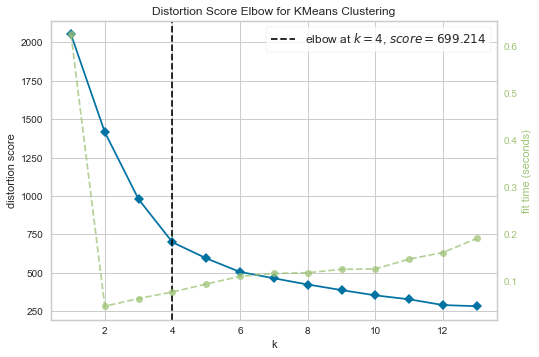

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [301]:
kmeanModel = KMeans(random_state=50)
visualizer = KElbowVisualizer(kmeanModel, k =(1,14))
visualizer.fit(Xsel)
visualizer.show()

In [302]:
# distortions = []
# K = range(1,10)
# for k in K:
#     kmeanModel = KMeans(n_clusters=k)
#     kmeanModel.fit(Xcorr)
#     distortions.append(kmeanModel.inertia_)

# plt.subplots(figsize=(16,8))
# plt.plot(K, distortions, 'bx-')
# plt.xlabel('k')
# plt.ylabel('Distortion')
# plt.title('The Elbow Method showing the optimal k')
# plt.show()

In [303]:
kmeanModel2 = KMeans(n_clusters=2)
kmeanModel2.fit(Xsel)

KMeans(n_clusters=2)

In [304]:
kmeanModel3 = KMeans(n_clusters=3)
kmeanModel3.fit(Xsel)

KMeans(n_clusters=3)

In [305]:
kmeanModel4 = KMeans(n_clusters=4)
kmeanModel4.fit(Xsel)

KMeans(n_clusters=4)

In [306]:
kmeanModel5 = KMeans(n_clusters=5)
kmeanModel5.fit(Xsel)

KMeans(n_clusters=5)

In [307]:
print(silhouette_score(Xsel, kmeanModel2.labels_, metric='euclidean'))
print(silhouette_score(Xsel, kmeanModel3.labels_, metric='euclidean'))
print(silhouette_score(Xsel, kmeanModel4.labels_, metric='euclidean'))
print(silhouette_score(Xsel, kmeanModel5.labels_, metric='euclidean'))

0.4017472264102927
0.5491804914879558
0.6437762203957512
0.6780961596410005


#Uniquement les variables qtitatives : 
0.6017882659412467 # 2 clusters
0.5425378110832533 # 3 clusters

In [308]:
Xsel

,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Divorced,Married,Single,Together,Widow,Income
0,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.351086
1,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.277680
2,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,0.434956
3,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,0.155079
4,0,0,0,0,0,0.0,1.0,0.0,0.0,0.0,0.352051
...,...,...,...,...,...,...,...,...,...,...,...
2003,0,0,0,0,0,0.0,0.0,1.0,0.0,0.0,0.156137
2004,0,0,0,0,0,0.0,1.0,0.0,0.0,0.0,0.370288
2005,0,1,0,0,0,1.0,0.0,0.0,0.0,0.0,0.343885
2006,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,0.420217


In [396]:
campaign_df['kmeansXsel'] = kmeanModel5.predict(Xsel)

C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnin

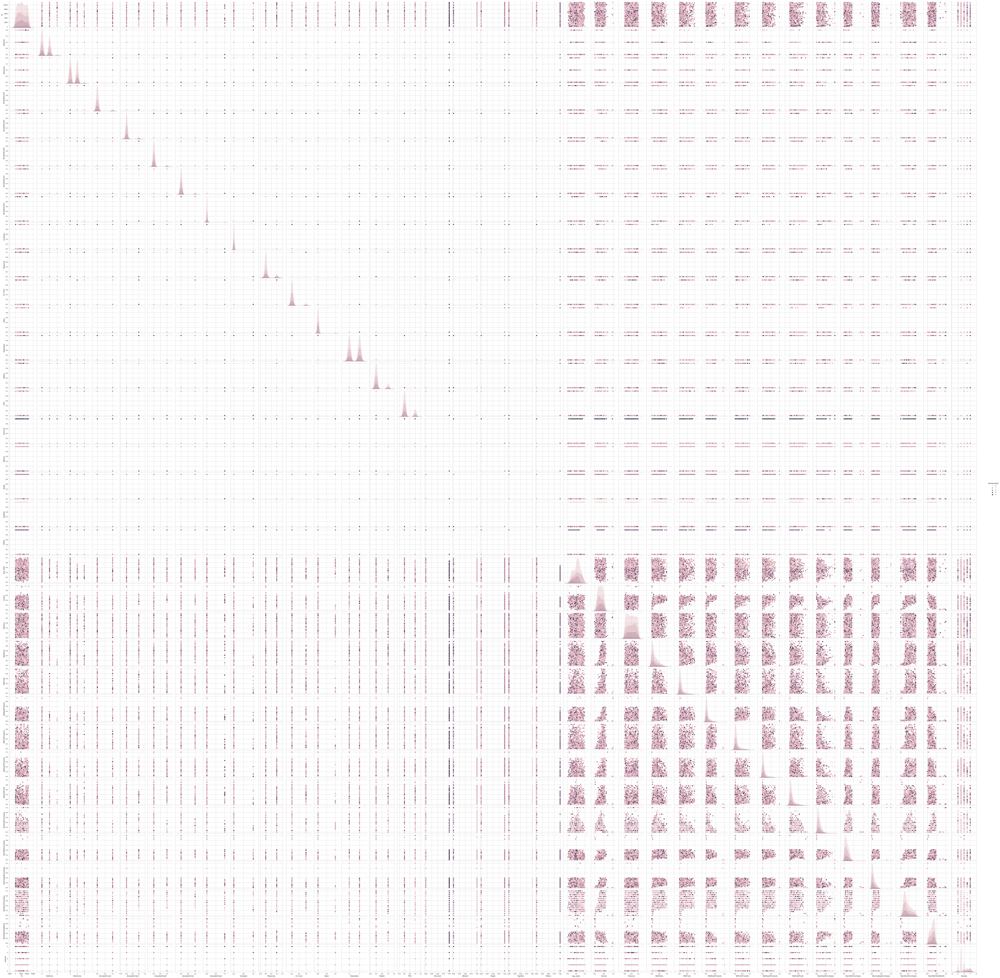

In [397]:
sns.pairplot(campaign_df, hue='kmeansXsel')

In [398]:
people = campaign_df[['ID','Year_Birth','Education','Marital_Status','Income','Kidhome','Teenhome','Dt_Customer','Recency','Complain']]
products = campaign_df[['ID', 'MntWines','MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds']]
promotion = campaign_df[['ID','NumDealsPurchases','AcceptedCmp1','AcceptedCmp2','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response']]
place = campaign_df[['ID','NumWebPurchases','NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth']]

KeyError: "['Marital_Status', 'Education'] not in index"

### ACP

In [312]:
from sklearn.decomposition import PCA

In [321]:
#instanciation
acp = PCA(svd_solver='full')
ft_acp = acp.fit(Xcorr)
#calculs
coord_campaign = ft_acp.transform(Xcorr)

In [314]:
p = acp.n_components_
n = len(Xcorr)
eigval = (n-1)/n*acp.explained_variance_

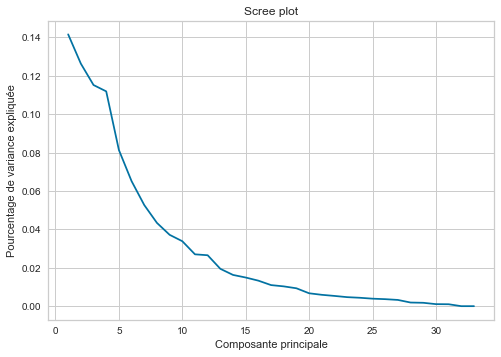

In [315]:
#scree plot
plt.plot(np.arange(1,p+1),acp.explained_variance_ratio_)
plt.title("Scree plot")
plt.ylabel("Pourcentage de variance expliquée")
plt.xlabel("Composante principale")
plt.show()

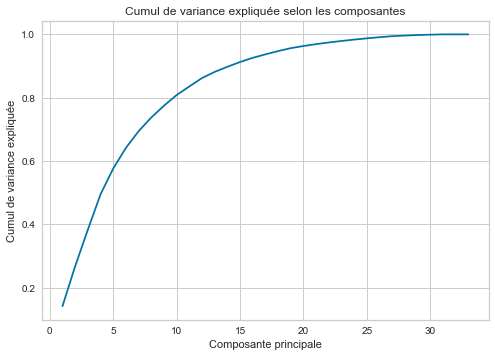

In [316]:
#cumul de variance expliquée
plt.plot(np.arange(1,p+1),np.cumsum(acp.explained_variance_ratio_))
plt.title("Cumul de variance expliquée selon les composantes")
plt.ylabel("Cumul de variance expliquée")
plt.xlabel("Composante principale")
plt.show()

In [318]:
#corrélation des variables avec les axes
corvar = np.zeros((p,p))
for k in range(p):
 corvar[:,k] = acp.components_[k,:] * np.sqrt(eigval)[k]

#on affiche pour les deux premiers axes
pd.DataFrame({'id':Xcorr.columns,'COR_1':corvar[:,0],'COR_2':corvar[:,1],'COR_3':corvar[:,2]})

,id,COR_1,COR_2,COR_3
0,Kidhome,0.488141,-0.085393,-0.037977
1,Teenhome,0.053808,0.331937,0.215180
2,AcceptedCmp3,-0.009269,-0.012218,-0.017860
3,AcceptedCmp4,-0.072012,0.019022,-0.001764
4,AcceptedCmp5,-0.108840,-0.025014,-0.026084
5,AcceptedCmp1,-0.093633,-0.025088,-0.013052
6,AcceptedCmp2,-0.017811,-0.001508,-0.005879
7,Complain,0.003266,-0.003616,0.001379
8,Response,-0.096666,-0.037495,-0.085796
9,2n Cycle,0.015231,0.022357,-0.045142


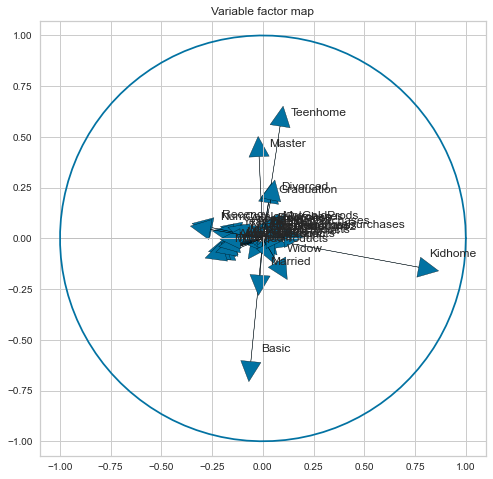

In [319]:
# Plot a variable factor map for the first two dimensions.
(fig, ax) = plt.subplots(figsize=(8, 8))
for i in range(0, acp.components_.shape[1]):
    ax.arrow(0,
             0,  # Start the arrow at the origin
             acp.components_[0, i],  #0 for PC1
             acp.components_[1, i],  #1 for PC2
             head_width=0.1,
             head_length=0.1)

    plt.text(acp.components_[0, i] + 0.05,
             acp.components_[1, i] + 0.05,
             X.columns.values[i])

#ajouter les axes
plt.plot([-1,1],[0,0],color='silver',linestyle='-',linewidth=1)
plt.plot([0,0],[-1,1],color='silver',linestyle='-',linewidth=1)

an = np.linspace(0, 2 * np.pi, 100)
plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale
plt.axis('equal')
ax.set_title('Variable factor map')
plt.show()

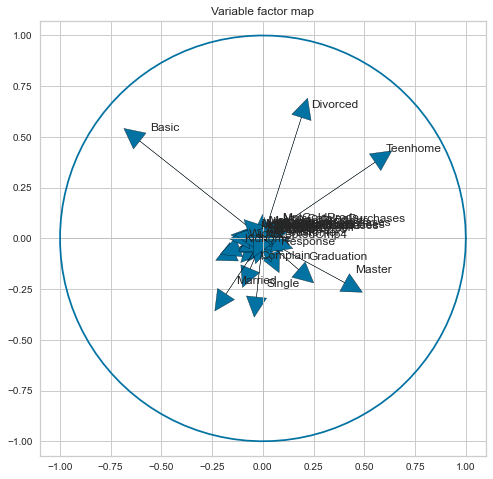

In [320]:
# Plot a variable factor map for the first two dimensions.
(fig, ax) = plt.subplots(figsize=(8, 8))
for i in range(0, acp.components_.shape[1]):
    ax.arrow(0,
             0,  # Start the arrow at the origin
             acp.components_[1, i],  #0 for PC1
             acp.components_[2, i],  #1 for PC2
             head_width=0.1,
             head_length=0.1)

    plt.text(acp.components_[1, i] + 0.05,
             acp.components_[2, i] + 0.05,
             X.columns.values[i])

#ajouter les axes
plt.plot([-1,1],[0,0],color='silver',linestyle='-',linewidth=1)
plt.plot([0,0],[-1,1],color='silver',linestyle='-',linewidth=1)

an = np.linspace(0, 2 * np.pi, 100)
plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale
plt.axis('equal')
ax.set_title('Variable factor map')
plt.show()

In [389]:
cc = coord_campaign[:,0:9]

In [390]:
cvar = corvar[:,0:4]

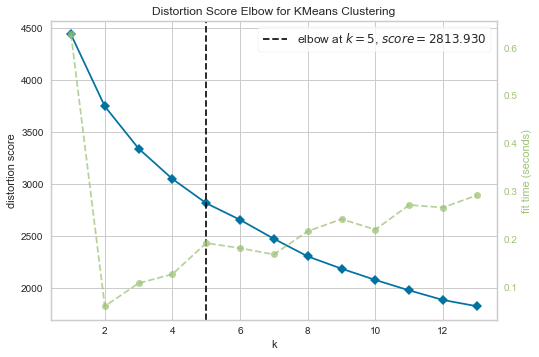

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [391]:
kmeanModel = KMeans(random_state=50)
visualizer = KElbowVisualizer(kmeanModel, k =(1,14))
visualizer.fit(cc)
visualizer.show()

In [392]:
kmeanModelacp5 = KMeans(n_clusters=5)
kmeanModelacp5.fit(cc)

KMeans(n_clusters=5)

In [393]:
# print(silhouette_score(Xsel, kmeanModel2.labels_, metric='euclidean'))
# print(silhouette_score(Xsel, kmeanModel3.labels_, metric='euclidean'))
# print(silhouette_score(Xsel, kmeanModel4.labels_, metric='euclidean'))
print(silhouette_score(cc, kmeanModelacp5.labels_, metric='euclidean'))

0.1909407139457301


In [394]:
campaign_df['kmeans'] = kmeanModelacp5.predict(cc)

C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Admin\Anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnin

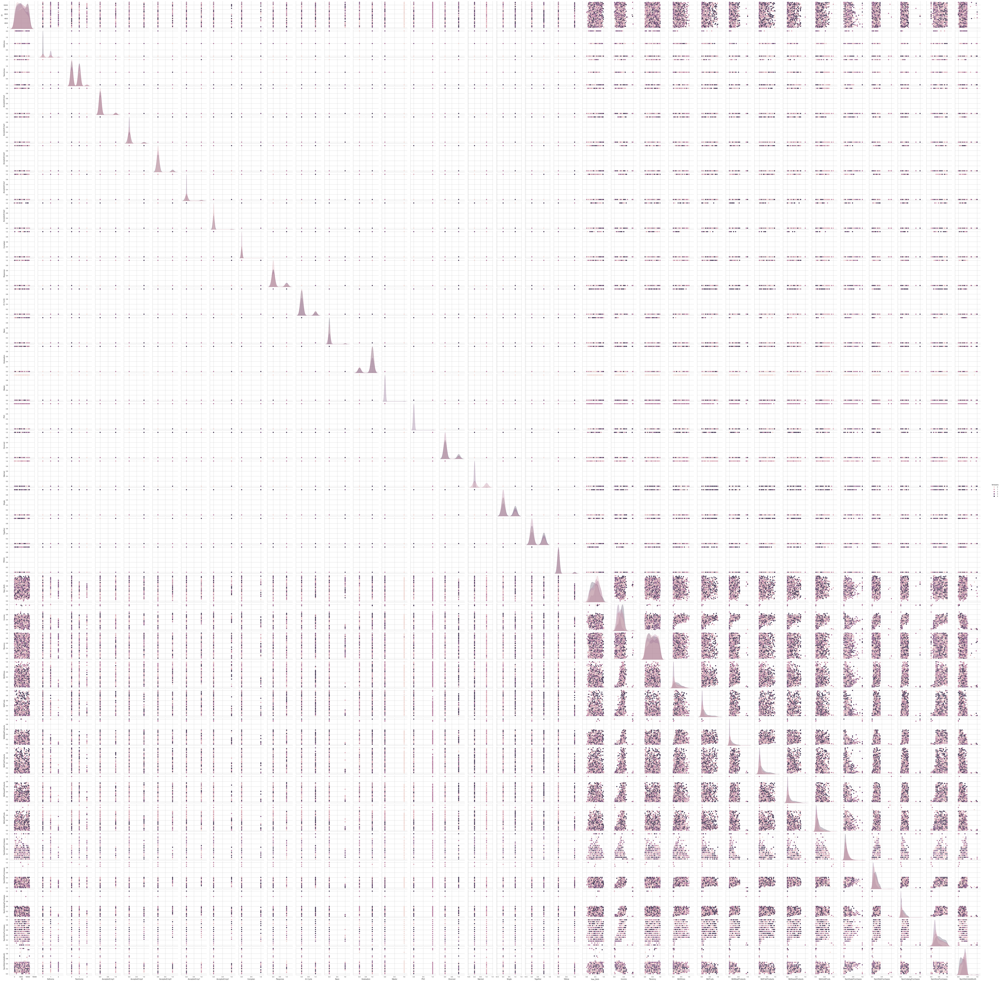

In [395]:
sns.pairplot(campaign_df, hue="kmeans")

# RFM selon les campagnes

# Conlusions